# Tutorial of using data painter in PyGWalker(snowflake)

Data painter is a new feature avaiable in pygwalker `0.3.19a+`, it is a new way to clean or transform your data in ad-hoc exploration.

This tutorial will show how to use data painter to create new feature that does not existed in original datasets.

And then it will provide another example how to use data painter to clean the data without any coding.

How to load csv data to snowfalke, please refer it: https://docs.snowflake.com/en/user-guide/data-load-web-ui

In [12]:
import pygwalker as pyg
from pygwalker.data_parsers.database_parser import Connector
import pandas as pd

We are going to use the bike sharing dataset.

In [2]:
conn = Connector(
    "snowflake://<user_name>:<password>@<account>/<database>/<schema>",
    """
        SELECT
            *
        FROM
            <your table path>
    """
)

Box(children=(HTML(value='<div id="ifr-pyg-00060ceb23911029O9lrPvnTUsCJ2VSZ" style="height: auto">\n    <head>…


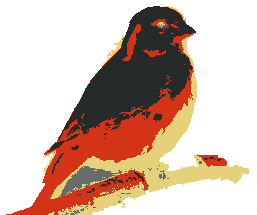

In [5]:
pyg.walk(conn, spec="ksf://bpknjjkdyyryb/demos/bike_get_start")

Box(children=(HTML(value='<div id="ifr-pyg-00060ceb2749182f4xEyfN7KhZuGQBnp" style="height: auto">\n    <head>…


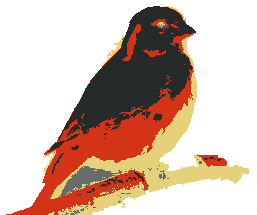

In [7]:
walker = pyg.walk(conn, spec="ksf://bpknjjkdyyryb/demos/bike_create_new_feature_with_painter")

### Export dataframe

Click the export dataframe, the labeled/cleaned data can be exported to `walker.last_exported_dataframe`

In [10]:
if walker.last_exported_dataframe is not None:
    walker.last_exported_dataframe.to_csv("./dataframes/labeled_bikesharing_data.csv", index=False)

Box(children=(HTML(value='<div id="ifr-pyg-00060ceb3d527110yn0Gdb8rvOux4EAW" style="height: auto">\n    <head>…


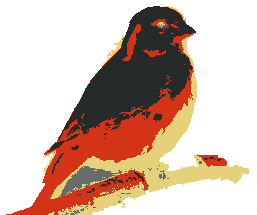

In [14]:
labled_df = pd.read_csv("./dataframes/labeled_bikesharing_data.csv")
pyg.walk(labled_df, spec="ksf://bpknjjkdyyryb/demos/bike_show_new_feature_with_painter.json")

In [7]:
## Data Cleanning

Box(children=(HTML(value='<div id="ifr-pyg-00060ceb426f6737mAJ2tfOvnpIRzYH7" style="height: auto">\n    <head>…


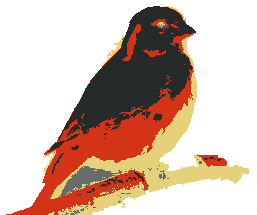

In [16]:
walker2 = pyg.walk(conn, spec="ksf://bpknjjkdyyryb/demos/bike_clean_data")

In [19]:
if walker2.last_exported_dataframe is not None:
    walker2.last_exported_dataframe.to_csv("./dataframes/cleaned_bikesharing_data.csv", index=False)

Box(children=(HTML(value='<div id="ifr-pyg-00060ceb5034d475Fm3Y6VdCObUBDJE2" style="height: auto">\n    <head>…


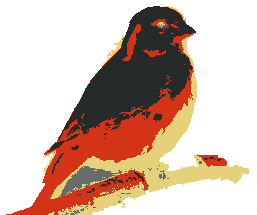

In [20]:
cleaned_df = pd.read_csv("./dataframes/cleaned_bikesharing_data.csv")
pyg.walk(cleaned_df, spec="ksf://bpknjjkdyyryb/demos/exported_cleaned_data")